In [1]:
# enable autoreload
%load_ext autoreload
%autoreload 2
%matplotlib inline

import os
import random

import scvi
scvi.settings.seed = 0
import scanpy as sc
import anndata as ad
import torch
import numpy as np
import pandas as pd
from datetime import datetime
from scipy.sparse import csr_matrix
torch.set_float32_matmul_precision('medium')
import warnings
warnings.simplefilter("ignore", UserWarning)
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
import seaborn as sns

# from scfair.evaluate import *
# from scfair_reproducibility.evaluation.metrics import *

from dis2p import dis2pvi_cE as dvi
# from dis2p_reproducibility.dis2p_defunct import dis2pvi_cE as dvi
import biolord
from scvi.model.base import BaseModelClass
from scDisInFact import scdisinfact, create_scdisinfact_dataset

# from dis2p_reproducibility.dis2p_defunct import dis2pvi as dvi

import scib

from sklearn.metrics import r2_score
from scipy.stats import pearsonr
import warnings
from tqdm import tqdm
warnings.filterwarnings("ignore")

Global seed set to 0
Global seed set to 0


In [2]:
%cd /lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/dis2p_reproducibility

/lustre/scratch126/cellgen/team205/aa34/Arian/Dis2P/dis2p_reproducibility


In [3]:
adata = sc.read_h5ad('../eraslan_preprocessed1212_split_deg.h5ad')
adata_biolord = sc.read_h5ad('../eraslan_preprocessed1212_split_deg.h5ad')

In [4]:
adata = adata[adata.layers['counts'].sum(1) != 0].copy()
adata_biolord = adata_biolord[adata_biolord.layers['counts'].sum(1) != 0].copy()

In [13]:
cats = ['tissue', 'Sample ID', 'sex', 'Age_bin']
pre_path = '../models/'

split_name = 'split_1'
dis2p_model_path = 'dis2p_cE_split_1/' + f'pretrainAE_0_maxEpochs_1000_split_{split_name}_reconW_20_cfWeight_0.8_beta_0.003_clf_0.05_adv_0.014_advp_5_n_cf_1_lr_0.003_wd_5e-05_new_cf_True_dropout_0.1_n_hidden_128_n_latent_32_n_layers_2_batch_size_256_NoCT'
biolord_model_path = f'biolord/eraslan_biolord_NoCT_earlierStop_basicSettings_nb_{split_name}/'
scdisinfact_model_path = f'scDisInfact/eraslan_scdisinfact_NoCT_defaultSettings_f{split_name}.pth'

## Load Dis2P

In [14]:
adata.obs['_cluster'] = '0' # Dummy obs for inference (not-training) time, to avoid computing neighbors and clusters again in setup_anndata | AVOID ADDING BEFORE TRAINING

model = dvi.Dis2pVI_cE.load(f"{pre_path}/{dis2p_model_path}", adata=adata)

INFO     File                                                                                                      
         ../models//dis2p_cE_split_1/pretrainAE_0_maxEpochs_1000_split_split_1_reconW_20_cfWeight_0.8_beta_0.003_cl
         f_0.05_adv_0.014_advp_5_n_cf_1_lr_0.003_wd_5e-05_new_cf_True_dropout_0.1_n_hidden_128_n_latent_32_n_layers
         _2_batch_size_256_NoCT/model.pt already downloaded                                                        


Cluster covariate already present in adata.obs, remove in case you want to re-run, skipping!
An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.


## Load Biolord

In [15]:
biolord_model = biolord.Biolord.load(f"{pre_path}/{biolord_model_path}", adata=adata_biolord)

INFO     File ../models//biolord/eraslan_biolord_NoCT_earlierStop_basicSettings_nb_split_1/model.pt already        
         downloaded                                                                                                


Global seed set to 42


## Load scDisInfact

In [16]:
from scDisInFact import scdisinfact, create_scdisinfact_dataset
import pandas as pd

# declare latent dimensions, we have two condition types, so there are three element corresponding to 
# shared-bio factor, unshared-bio factor for condition 1, unshared-bio factor for condition 2
# default setting of hyper-parameters
reg_mmd_comm = 1e-4
reg_mmd_diff = 1e-4
reg_kl_comm = 1e-5
reg_kl_diff = 1e-2
reg_class = 1
reg_gl = 1

Ks = [40, 10, 10, 10, 10]
batch_size = 64
nepochs = 100
interval = 10
lr = 5e-4

lambs = [reg_mmd_comm, reg_mmd_diff, reg_kl_comm, reg_kl_diff, reg_class, reg_gl]
batch_size = 64
adata_ = adata[adata.layers['counts'].sum(1) != 0].copy()
counts = adata_.layers['counts'].copy()
meta_cells = adata_.obs.copy()
meta_cells['one'] = pd.Categorical([1 for _ in range(adata_.n_obs)])

condition_key = ['tissue', 'Sample ID', 'sex', 'Age_bin']

data_dict = create_scdisinfact_dataset(counts, meta_cells, condition_key = condition_key, batch_key = "one")

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
scdisinfact_model = scdisinfact(data_dict = data_dict, Ks = Ks, batch_size = batch_size, interval = interval, lr = lr, 
                    reg_mmd_comm = reg_mmd_comm, reg_mmd_diff = reg_mmd_diff, reg_gl = reg_gl, reg_class = reg_class, 
                    reg_kl_comm = reg_kl_comm, reg_kl_diff = reg_kl_diff, seed = 0, device = device)
scdisinfact_model.load_state_dict(torch.load(f"{pre_path}/{scdisinfact_model_path}", map_location = device))

Sanity check...
Finished.
Create scDisInFact datasets...
Finished.


<All keys matched successfully>

In [17]:
# Z_0
adata.obsm[f'dis2p_cE_Z_0'] = model.get_latent_representation(nullify_cat_covs_indices=[s for s in range(len(cats))], nullify_shared=False)

for i in range(len(cats)):
    null_idx = [s for s in range(len(cats)) if s != i]
    # Z_i
    adata.obsm[f'dis2p_cE_Z_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=null_idx, nullify_shared=True)
    # Z_{-i}
    adata.obsm[f'dis2p_cE_Z_not_{i+1}'] = model.get_latent_representation(nullify_cat_covs_indices=[i], nullify_shared=False)

In [18]:
for i, cat in enumerate(cats):
    nullify = [c for c in cats if c != cat]
    latent_unknown_attributes_adata, latent_adata = biolord_model.get_latent_representation_adata(
        adata=adata_biolord,
        nullify_attribute=nullify,
    )
    adata.obsm[f'Biolord_Z_{i+1}'] = latent_adata.X.copy()

    nullify = [cat]
    latent_unknown_attributes_adata, latent_adata = biolord_model.get_latent_representation_adata(
        adata=adata_biolord,
        nullify_attribute=nullify,
    )
    adata.obsm[f'Biolord_Z_not_{i+1}'] = np.concatenate([latent_adata.X.copy()], axis=1)

adata.obsm[f'Biolord_Z_0'] = latent_unknown_attributes_adata.X.copy()

In [19]:
# one forward pass
z_cs = []
z_ds = []
zs = []

# loop through all training count matrices
for dataset in data_dict["datasets"]:
    with torch.no_grad():
        # pass through the encoders
        dict_inf = scdisinfact_model.inference(counts = dataset.counts_norm.to(scdisinfact_model.device), batch_ids = dataset.batch_id[:,None].to(scdisinfact_model.device), print_stat = False)
        # pass through the decoder
        dict_gen = scdisinfact_model.generative(z_c = dict_inf["mu_c"], z_d = dict_inf["mu_d"], batch_ids = dataset.batch_id[:,None].to(scdisinfact_model.device))
        z_c = dict_inf["mu_c"]
        z_d = dict_inf["mu_d"]
        mu = dict_gen["mu"]    
        z_ds.append([x.cpu().detach().numpy() for x in z_d])
        z_cs.append(z_c.cpu().detach().numpy())

# shared-bio factor, concatenate across all training matrices
z_cs = np.concatenate(z_cs, axis = 0)
adata.obsm[f'scDisInfact_Z_0'] = z_cs.copy()

# unshared-bio factors for conditions 1 and 2
for i, cat in enumerate(cats):
    z_ds_cond = np.concatenate([x[i] for x in z_ds], axis = 0)
    adata.obsm[f'scDisInfact_Z_{i+1}'] = z_ds_cond.copy()

for i in range(1, len(cats)+1):
    
    z_not_ds_cond = np.concatenate([adata.obsm[f'scDisInfact_Z_{j}'].copy() for j in range(len(cats)+1) if j != i], axis=1)
    adata.obsm[f'scDisInfact_Z_not_{i}'] = z_not_ds_cond.copy()

In [21]:
for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'dis2p_cE_Z_{i}'
    print(latent_name)
    latent = ad.AnnData(X=adata.obsm[f"{latent_name}"], obs=adata.obs)
    # rsc.get.anndata_to_GPU(latent)
    sc.pp.neighbors(adata=latent, use_rep='X')
    # rsc.pp.neighbors(adata=latent, use_rep='X')
    sc.tl.umap(adata=latent)
    # rsc.get.anndata_to_CPU(latent)

    adata.uns[f'{latent_name}_neighbors'] = latent.uns['neighbors']
    adata.obsm[f'{latent_name}_umap'] = latent.obsm['X_umap']

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'scDisInfact_Z_{i}'
    print(latent_name)

    latent = ad.AnnData(X=adata.obsm[f"{latent_name}"], obs=adata.obs)
    # rsc.get.anndata_to_GPU(latent)
    sc.pp.neighbors(adata=latent, use_rep='X')
    # rsc.pp.neighbors(adata=latent, use_rep='X')
    sc.tl.umap(adata=latent)
    # rsc.get.anndata_to_CPU(latent)

    adata.uns[f'{latent_name}_neighbors'] = latent.uns['neighbors']
    adata.obsm[f'{latent_name}_umap'] = latent.obsm['X_umap']

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'Biolord_Z_{i}'
    print(latent_name)

    latent = ad.AnnData(X=adata.obsm[f"{latent_name}"], obs=adata.obs)
    # rsc.get.anndata_to_GPU(latent)
    sc.pp.neighbors(adata=latent, use_rep='X')
    # rsc.pp.neighbors(adata=latent, use_rep='X')
    sc.tl.umap(adata=latent)
    # rsc.get.anndata_to_CPU(latent)

    adata.uns[f'{latent_name}_neighbors'] = latent.uns['neighbors']
    adata.obsm[f'{latent_name}_umap'] = latent.obsm['X_umap']

dis2p_cE_Z_0
dis2p_cE_Z_1
dis2p_cE_Z_2
dis2p_cE_Z_3
dis2p_cE_Z_4
scDisInfact_Z_0
scDisInfact_Z_1
scDisInfact_Z_2
scDisInfact_Z_3
scDisInfact_Z_4
Biolord_Z_0
Biolord_Z_1
Biolord_Z_2
Biolord_Z_3
Biolord_Z_4


In [22]:
cats

['tissue', 'Sample ID', 'sex', 'Age_bin']

---UMAP for dis2p_cE_Z_0---


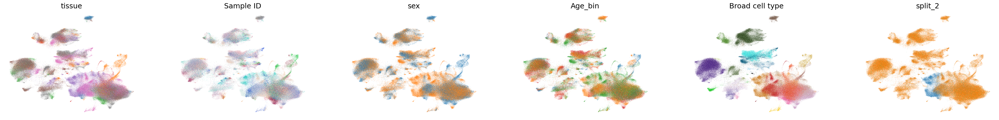

---UMAP for dis2p_cE_Z_1---
tissue


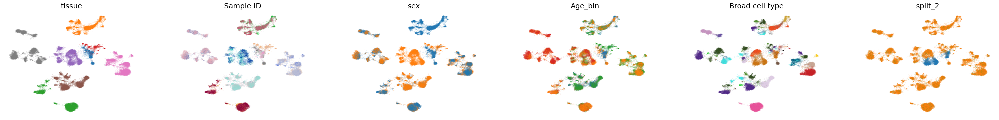

---UMAP for dis2p_cE_Z_2---
Sample ID


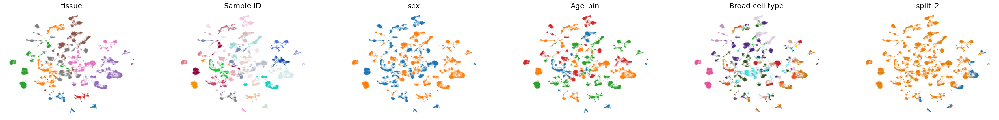

---UMAP for dis2p_cE_Z_3---
sex


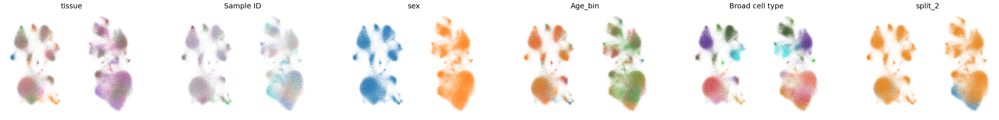

---UMAP for dis2p_cE_Z_4---
Age_bin


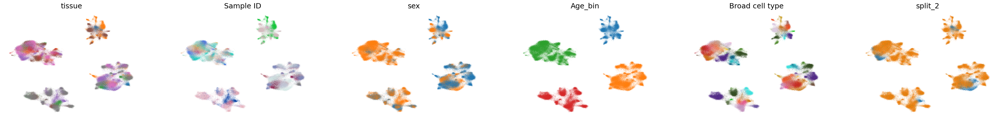

In [23]:
import warnings
warnings.filterwarnings("ignore")
random.seed(0)

nrow = len(cats) + 1
ncol = len(cats)

cats_ = ['tissue', 'Sample ID', 'sex', 'Age_bin', 'Broad cell type', 'split_2']

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'dis2p_cE_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])

    sc.pl.embedding(
        adata,
        f'{latent_name}_umap',
        color=cats_,
        ncols=len(cats_),
        frameon=False,
        legend_loc=None,
        # ax=axs[i][:]
    )

---UMAP for Biolord_Z_0---


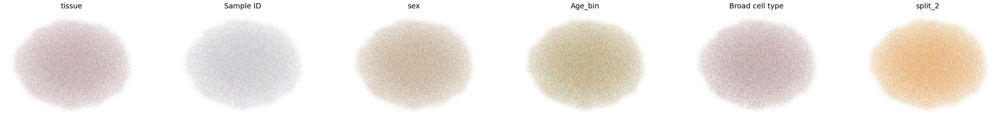

---UMAP for Biolord_Z_1---
tissue


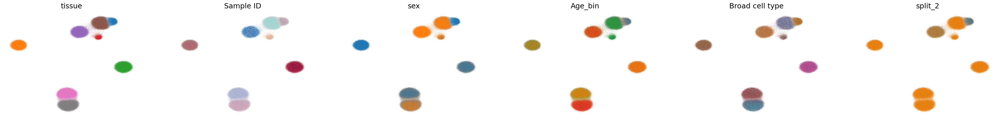

---UMAP for Biolord_Z_2---
Sample ID


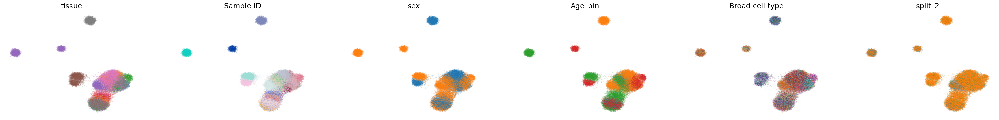

---UMAP for Biolord_Z_3---
sex


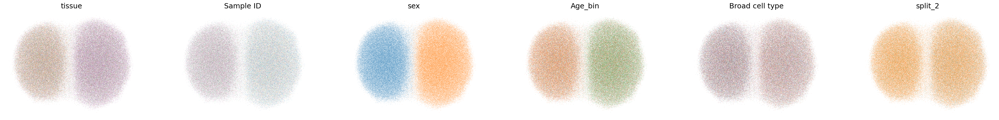

---UMAP for Biolord_Z_4---
Age_bin


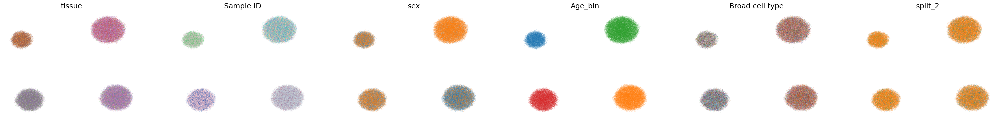

In [24]:
import warnings
warnings.filterwarnings("ignore")
random.seed(0)

nrow = len(cats) + 1
ncol = len(cats)

cats_ = ['tissue', 'Sample ID', 'sex', 'Age_bin', 'Broad cell type', 'split_2']

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'Biolord_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])

    sc.pl.embedding(
        adata,
        f'{latent_name}_umap',
        color=cats_,
        ncols=len(cats_),
        frameon=False,
        legend_loc=None,
        # ax=axs[i][:]
    )

---UMAP for scDisInfact_Z_0---


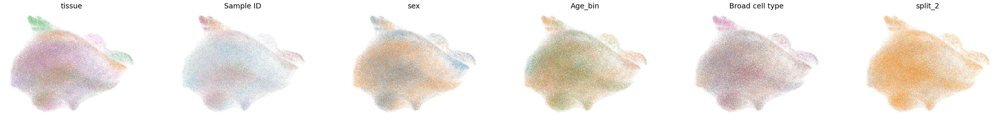

---UMAP for scDisInfact_Z_1---
tissue


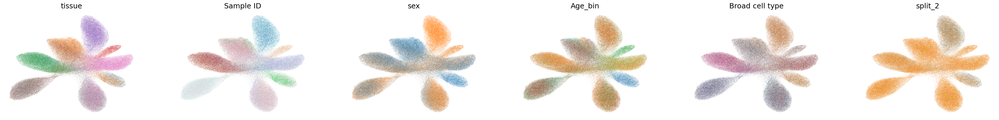

---UMAP for scDisInfact_Z_2---
Sample ID


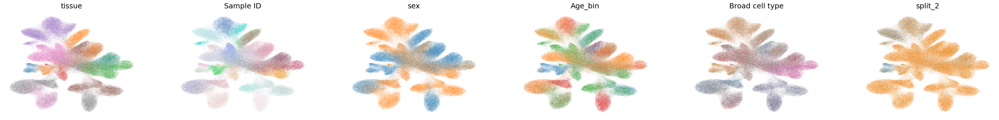

---UMAP for scDisInfact_Z_3---
sex


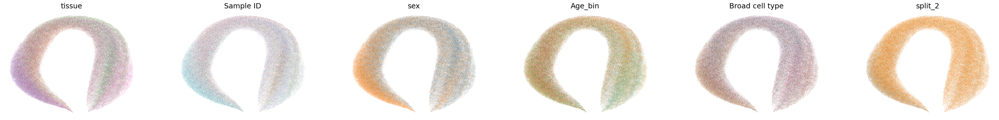

---UMAP for scDisInfact_Z_4---
Age_bin


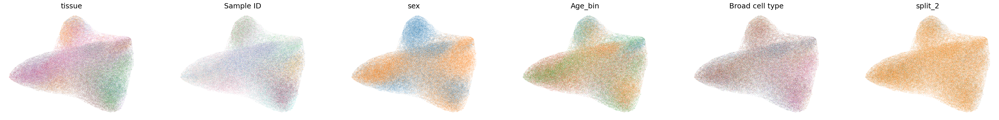

In [25]:
import warnings
warnings.filterwarnings("ignore")
random.seed(0)

nrow = len(cats) + 1
ncol = len(cats)

cats_ = ['tissue', 'Sample ID', 'sex', 'Age_bin', 'Broad cell type', 'split_2']

for i in range(len(cats) + 1):  # loop over all Z_i
    latent_name = f'scDisInfact_Z_{i}'

    print(f"---UMAP for {latent_name}---")
    if i != 0:
        print(cats[i - 1])

    sc.pl.embedding(
        adata,
        f'{latent_name}_umap',
        color=cats_,
        ncols=len(cats_),
        frameon=False,
        legend_loc=None,
        # ax=axs[i][:]
    )

---UMAP for dis2p_cE_Z_1---
tissue


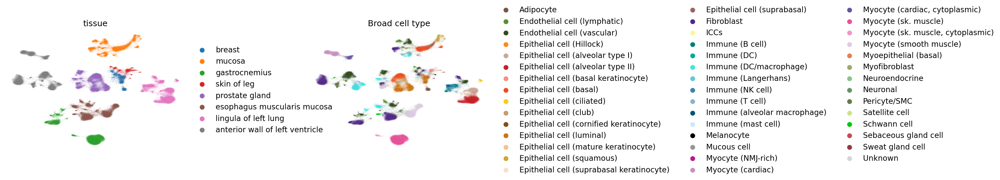

In [35]:
import warnings
warnings.filterwarnings("ignore")
random.seed(0)

cats_ = ['tissue', 'Sample ID', 'sex', 'Age_bin', 'Broad cell type']

nrow = len(cats) + 1
ncol = len(cats_)

i = 1
latent_name = f'dis2p_cE_Z_{i}'

print(f"---UMAP for {latent_name}---")
if i != 0:
    print(cats[i - 1])
sc.pl.embedding(
    adata,
    f'{latent_name}_umap',
    color=['tissue', 'Broad cell type'],
    # ncols=len(cats_),
    frameon=False,
    wspace=0.5,
    # legend_loc=None,
    # ax=axs[i][:]
)

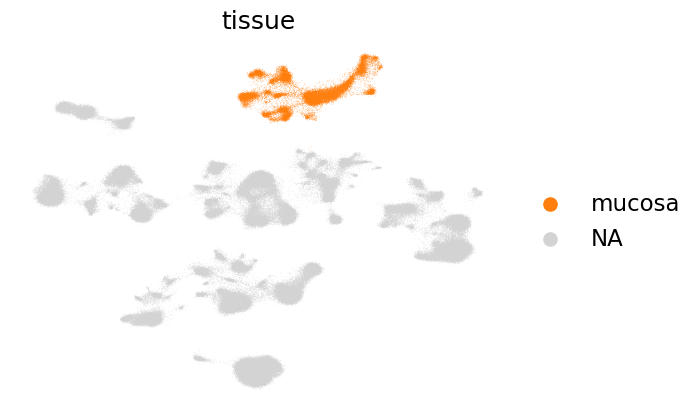

In [37]:
sc.pl.embedding(
    adata,
    f'{latent_name}_umap',
    color='tissue',
    groups=['mucosa'],
    # ncols=len(cats_),
    frameon=False,
    # legend_loc=None,
    # ax=axs[i][:]
)

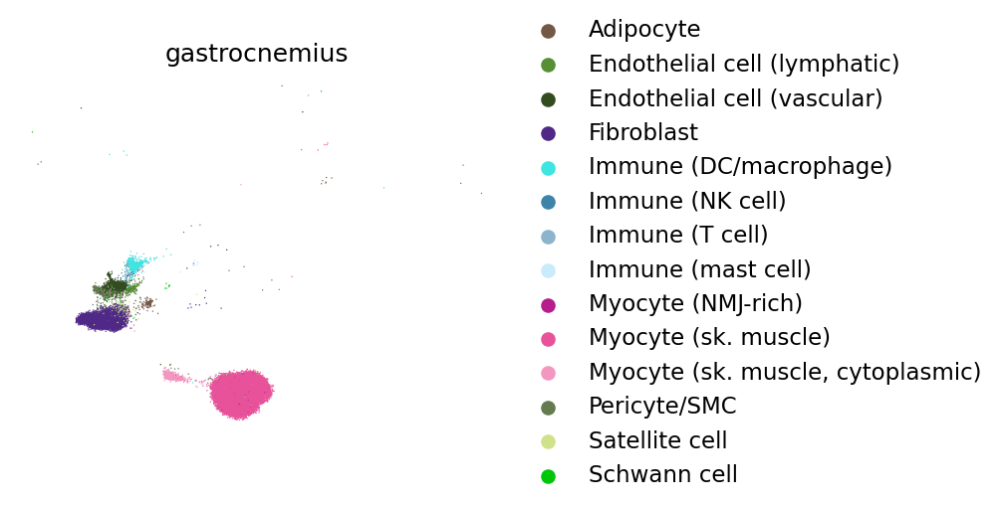

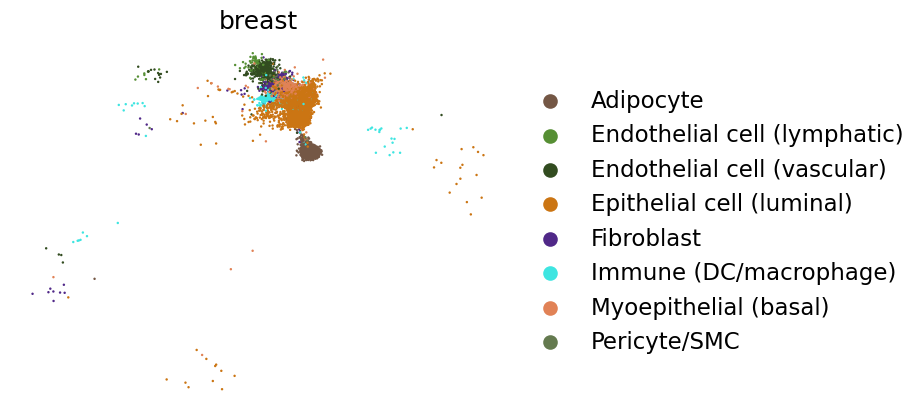

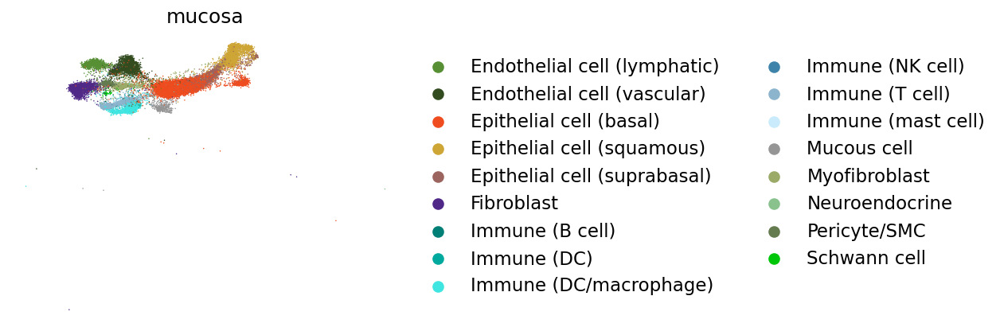

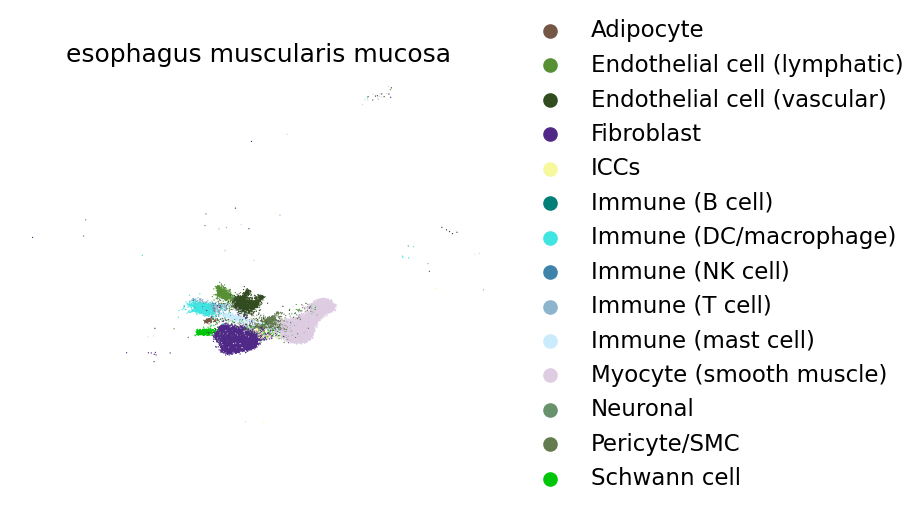

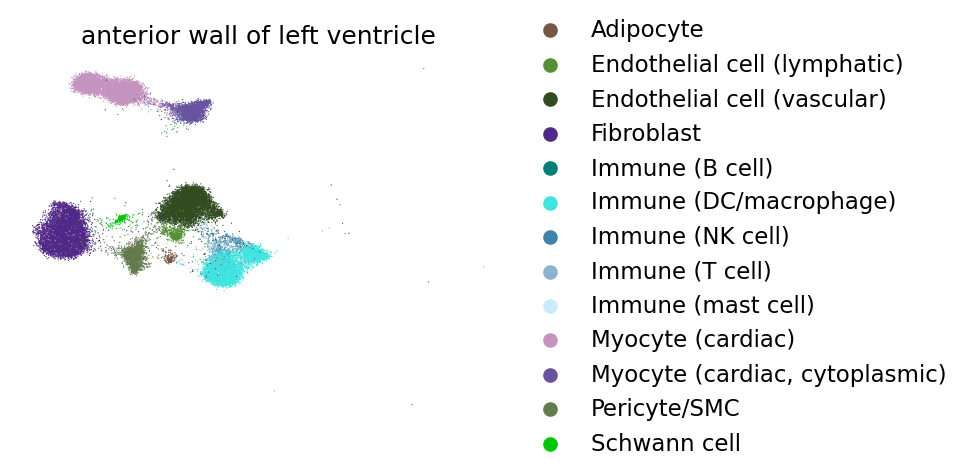

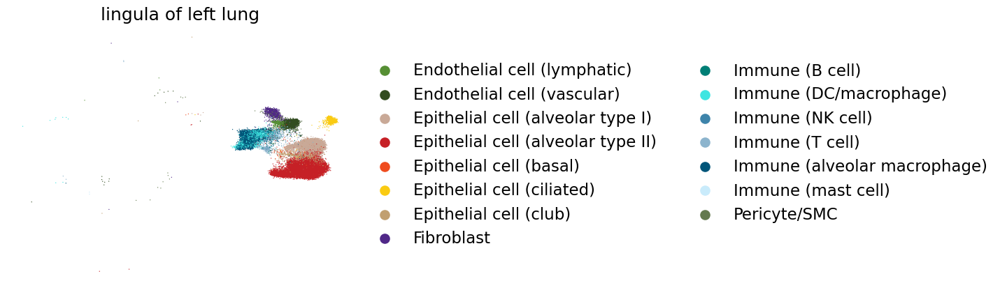

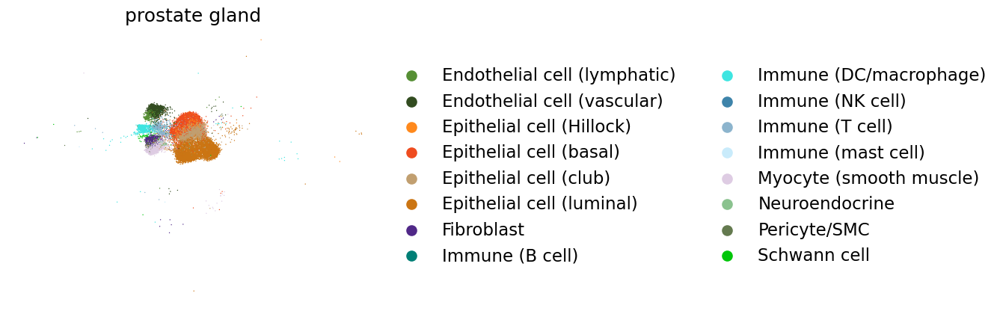

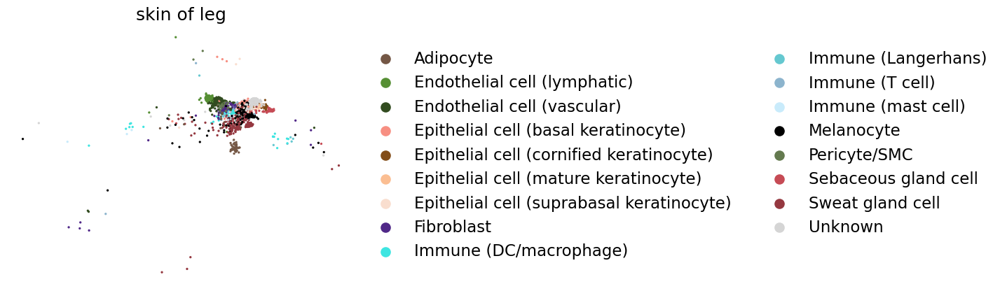

In [39]:
for tissue in adata.obs['tissue'].unique():
    sc.pl.embedding(
        adata[adata.obs['tissue'] == tissue],
        f'{latent_name}_umap',
        color='Broad cell type',
        # groups=['mucosa'],
        # ncols=len(cats_),
        frameon=False,
        title=tissue,
        # legend_loc=None,
        # ax=axs[i][:]
    )

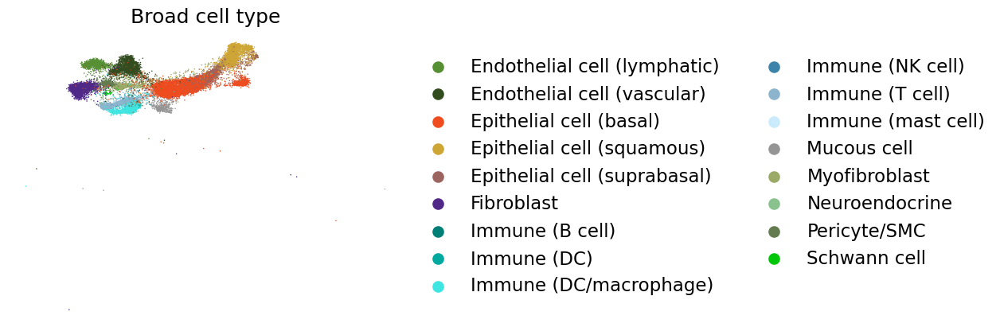

In [75]:
latent_name = 'dis2p_cE_Z_1'
sc.pl.embedding(
    adata[adata.obs['tissue'] == 'mucosa'],
    f'{latent_name}_umap',
    color='Broad cell type',
    # groups=['mucosa'],
    # ncols=len(cats_),
    frameon=False,
    # title=latent_name,
    show=True,
    # legend_loc=None,
    # ax=axs[i][:]
)

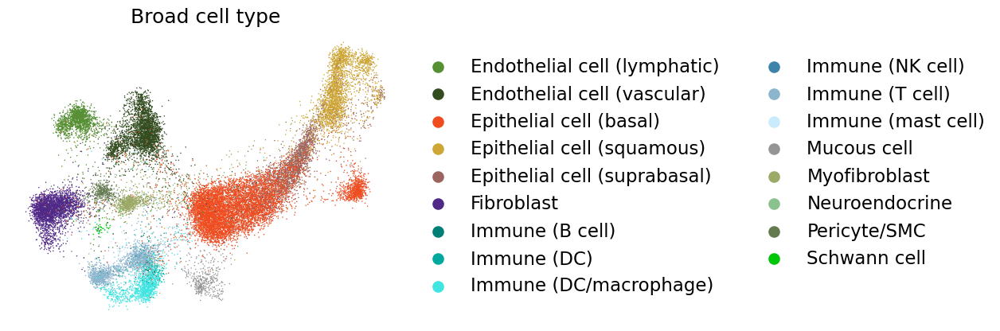

In [97]:
mean_umap = adata[adata.obs['tissue'] == 'mucosa'].obsm[f'{latent_name}_umap'].mean(0)

latent_name = 'dis2p_cE_Z_1'
sc.pl.embedding(
    adata[
    (adata.obs['tissue'] == 'mucosa') &
    (np.abs(adata.obsm[f'{latent_name}_umap'][:, 0] - mean_umap[0]) < 10) &
    (np.abs(adata.obsm[f'{latent_name}_umap'][:, 1] - mean_umap[1]) < 4.5) 
],
    f'{latent_name}_umap',
    color='Broad cell type',
    # groups=['mucosa'],
    # ncols=len(cats_),
    frameon=False,
    # title=latent_name,
    show=True,
    # legend_loc=None,
    # ax=axs[i][:]
)

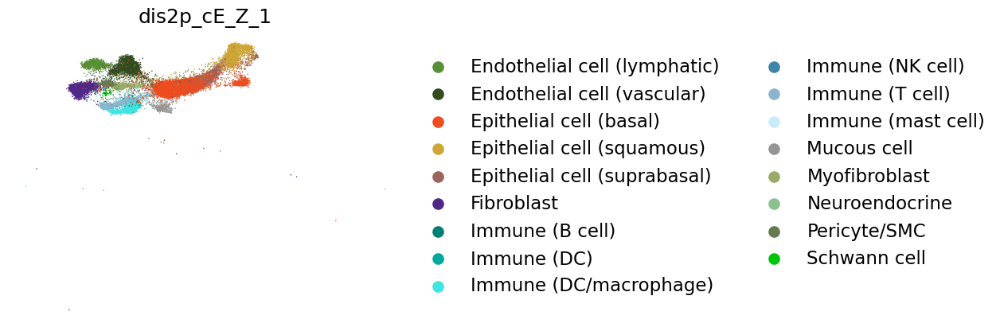

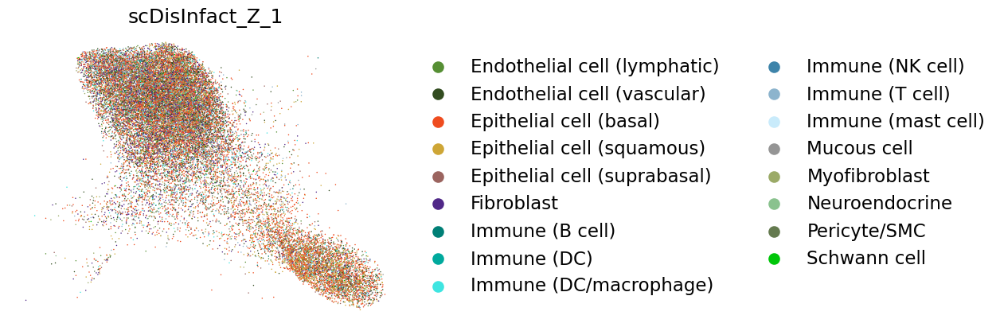

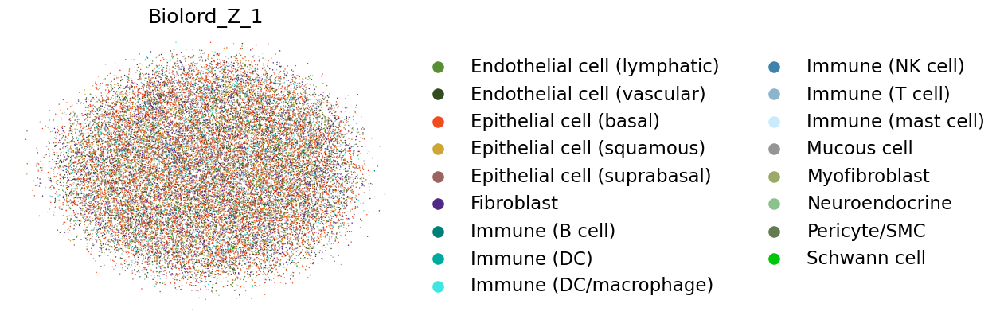

In [60]:
for latent_name in ['dis2p_cE_Z_1', 'scDisInfact_Z_1', 'Biolord_Z_1']:
    with plt.rc_context():  # Use this to set figure params like size and dpi
        # sc.pl.plotting_function(..., show=False)
        # plt.savefig("path/to/file.extension", bbox_inches="tight")
        sc.pl.embedding(
            adata[adata.obs['tissue'] == 'mucosa'],
            f'{latent_name}_umap',
            color='Broad cell type',
            # groups=['mucosa'],
            # ncols=len(cats_),
            frameon=False,
            title=latent_name,
            show=False,
            # legend_loc=None,
            # ax=axs[i][:]
        )
        plt.savefig(f'/nfs/users/nfs_a/aa34/figures/Final_Figures/publication_figure_notebooks/{latent_name}.png', 
                    bbox_inches="tight")

In [63]:
import gc
gc.collect()

from scib_metrics.benchmark import (
    BatchCorrection,
    Benchmarker,
    BioConservation,
)
# biocons = BioConservation(isolated_labels=False)
embedding_obsm_keys = [f'dis2p_cE_Z_0',
                       f'Biolord_Z_0',
                       f'scDisInfact_Z_0',]

adata_ = sc.pp.subsample(adata, fraction=0.1, copy=True)

bms = {}
for batch_key in cats:
    gc.collect()
    print(batch_key)
    bm = Benchmarker(
    # adata,
    adata_,
    batch_key=batch_key,
    label_key='Broad cell type',
    # bio_conservation_metrics=bio_conservation_metrics,
    # batch_correction_metrics=batch_correction_metrics,
    embedding_obsm_keys=embedding_obsm_keys,
    n_jobs=-1,
    )
    # bm.prepare(neighbor_computer=faiss_brute_force_nn)
    bm.benchmark()
    bms[batch_key] = bm

tissue


Metrics:  60%|██████    | 6/10 [06:05<02:11, 32.97s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (Hillock) consists of a single batch or is too small. Skip.                               
INFO     Epithelial cell (alveolar type I) consists of a single batch or is too small. Skip.                       
INFO     Epithelial cell (alveolar type II) consists of a single batch or is too small. Skip.                      
INFO     Epithelial cell (basal keratinocyte) consists of a single batch or is too small. Skip.                    
INFO     Epithelial cell (ciliated) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (squamous) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single 


Metrics:   0%|          | 0/10 [00:00<?, ?it/s]
                                                                                         
Metrics:  60%|██████    | 6/10 [00:14<00:05,  1.36s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (Hillock) consists of a single batch or is too small. Skip.                               
INFO     Epithelial cell (alveolar type I) consists of a single batch or is too small. Skip.                       
INFO     Epithelial cell (alveolar type II) consists of a single batch or is too small. Skip.                      
INFO     Epithelial cell (basal keratinocyte) consists of a single batch or is too small. Skip.                    
INFO     Epithelial cell (ciliated) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (squamous) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single 


Metrics:   0%|          | 0/10 [00:00<?, ?it/s]
                                                                                         
Metrics:  60%|██████    | 6/10 [02:01<00:42, 10.68s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (Hillock) consists of a single batch or is too small. Skip.                               
INFO     Epithelial cell (alveolar type I) consists of a single batch or is too small. Skip.                       
INFO     Epithelial cell (alveolar type II) consists of a single batch or is too small. Skip.                      
INFO     Epithelial cell (basal keratinocyte) consists of a single batch or is too small. Skip.                    
INFO     Epithelial cell (ciliated) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (squamous) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single 


Embeddings: 100%|██████ | 9/10 [02:09<00:05,  5.17s/it, Batch correction: pcr_comparison]██████████| 3/3 [08:53<00:00, 151.69s/it]██████████| 3/3 [08:53<00:00, 177.68s/it]

                                                                                         

Sample ID


Metrics:  60%|██████    | 6/10 [06:07<02:14, 33.55s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Myocyte (NMJ-rich) consists of a single batch or is too small. Skip.                                      
INFO     Neuronal consists of a single batch or is too small. Skip.                                                



Metrics:   0%|          | 0/10 [00:00<?, ?it/s]
                                                                                         
Metrics:  60%|██████    | 6/10 [00:14<00:05,  1.37s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Myocyte (NMJ-rich) consists of a single batch or is too small. Skip.                                      
INFO     Neuronal consists of a single batch or is too small. Skip.                                                



Metrics:   0%|          | 0/10 [00:00<?, ?it/s]
                                                                                         
Metrics:  60%|██████    | 6/10 [02:01<00:42, 10.73s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Myocyte (NMJ-rich) consists of a single batch or is too small. Skip.                                      
INFO     Neuronal consists of a single batch or is too small. Skip.                                                



Embeddings: 100%|██████ | 9/10 [02:09<00:05,  5.19s/it, Batch correction: pcr_comparison]██████████| 3/3 [08:55<00:00, 152.31s/it]██████████| 3/3 [08:55<00:00, 178.51s/it]

                                                                                         

sex


Metrics:  60%|██████    | 6/10 [05:59<02:08, 32.10s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (Hillock) consists of a single batch or is too small. Skip.                               
INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (squamous) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Epithelial cell (suprabasal) consists of a single batch or is too small. Skip.                            
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Mucous cell consists of a single batch or is too small. Skip.  


Metrics:   0%|          | 0/10 [00:00<?, ?it/s]
                                                                                         
Metrics:  60%|██████    | 6/10 [00:14<00:05,  1.26s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (Hillock) consists of a single batch or is too small. Skip.                               
INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (squamous) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Epithelial cell (suprabasal) consists of a single batch or is too small. Skip.                            
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Mucous cell consists of a single batch or is too small. Skip.  


Metrics:   0%|          | 0/10 [00:00<?, ?it/s]
                                                                                         
Metrics:  60%|██████    | 6/10 [02:00<00:42, 10.56s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (Hillock) consists of a single batch or is too small. Skip.                               
INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (squamous) consists of a single batch or is too small. Skip.                              
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Epithelial cell (suprabasal) consists of a single batch or is too small. Skip.                            
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Mucous cell consists of a single batch or is too small. Skip.  


Embeddings: 100%|██████ | 9/10 [02:11<00:05,  5.51s/it, Batch correction: pcr_comparison]██████████| 3/3 [08:50<00:00, 151.59s/it]██████████| 3/3 [08:50<00:00, 176.68s/it]

                                                                                         

Age_bin


Metrics:  60%|██████    | 6/10 [06:06<02:14, 33.57s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Myocyte (NMJ-rich) consists of a single batch or is too small. Skip.                                      
INFO     Neuronal consists of a single batch or is too small. Skip.                                                



Metrics:   0%|          | 0/10 [00:00<?, ?it/s]
                                                                                         
Metrics:  60%|██████    | 6/10 [00:15<00:05,  1.35s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Myocyte (NMJ-rich) consists of a single batch or is too small. Skip.                                      
INFO     Neuronal consists of a single batch or is too small. Skip.                                                



Metrics:   0%|          | 0/10 [00:00<?, ?it/s]
                                                                                         
Metrics:  60%|██████    | 6/10 [02:04<00:45, 11.26s/it, Batch correction: kbet_per_label]

INFO     Epithelial cell (cornified keratinocyte) consists of a single batch or is too small. Skip.                
INFO     Epithelial cell (mature keratinocyte) consists of a single batch or is too small. Skip.                   
INFO     Epithelial cell (suprabasal keratinocyte) consists of a single batch or is too small. Skip.               
INFO     Immune (DC) consists of a single batch or is too small. Skip.                                             
INFO     Immune (Langerhans) consists of a single batch or is too small. Skip.                                     
INFO     Myocyte (NMJ-rich) consists of a single batch or is too small. Skip.                                      
INFO     Neuronal consists of a single batch or is too small. Skip.                                                



Embeddings: 100%|██████ | 9/10 [02:15<00:05,  5.74s/it, Batch correction: pcr_comparison]██████████| 3/3 [09:00<00:00, 154.78s/it]██████████| 3/3 [09:00<00:00, 180.04s/it]

                                                                                         

tissue


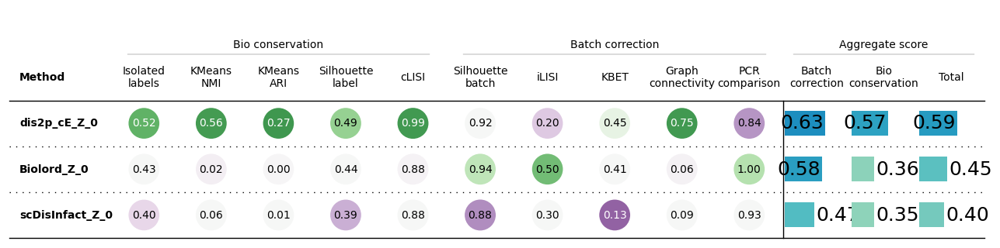

Sample ID


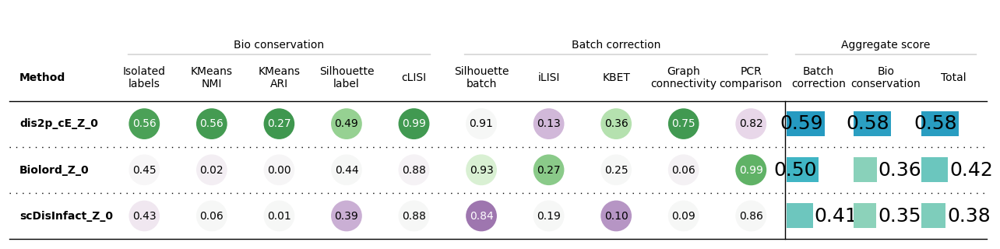

sex


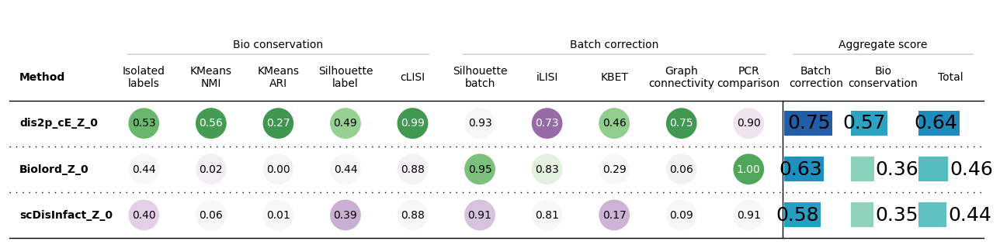

Age_bin


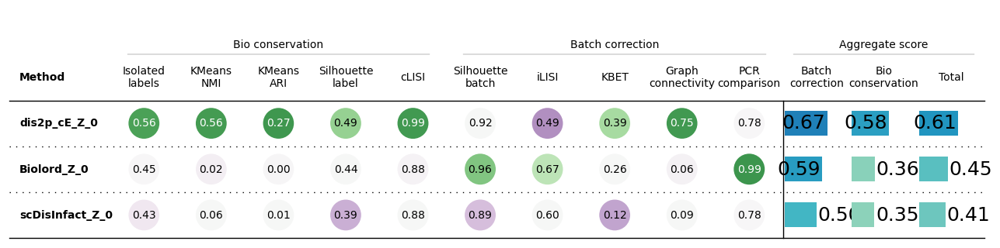

In [64]:
for name, bm in bms.items():
    print(name)
    bm.plot_results_table(min_max_scale=False)

In [65]:
df_cat = pd.concat([bm.get_results(min_max_scale=False).iloc[:-1] 
           for bm in bms.values()])
df_mean = df_cat.groupby(df_cat.index).mean()
df_mean.loc['Metric Type'] = bm.get_results(min_max_scale=False).loc['Metric Type']
df_mean

,Isolated labels,KMeans NMI,KMeans ARI,Silhouette label,cLISI,Silhouette batch,iLISI,KBET,Graph connectivity,PCR comparison,Batch correction,Bio conservation,Total
Embedding,,,,,,,,,,,,,
Biolord_Z_0,0.441545,0.020886,0.004907,0.437088,0.8798,0.944023,0.569416,0.301966,0.059023,0.996249,0.574135,0.356845,0.443761
dis2p_cE_Z_0,0.546067,0.559015,0.26977,0.494511,0.989442,0.916753,0.387402,0.417696,0.752589,0.833491,0.661586,0.571761,0.607691
scDisInfact_Z_0,0.417068,0.056999,0.009151,0.391061,0.884124,0.88057,0.474026,0.12759,0.090917,0.871403,0.488901,0.351681,0.406569
Metric Type,Bio conservation,Bio conservation,Bio conservation,Bio conservation,Bio conservation,Batch correction,Batch correction,Batch correction,Batch correction,Batch correction,Aggregate score,Aggregate score,Aggregate score


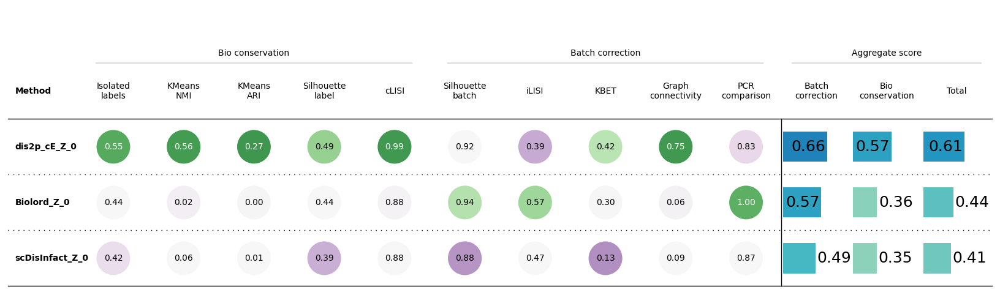

In [67]:
import os
import warnings
from dataclasses import asdict, dataclass
from enum import Enum
from functools import partial
from typing import Any, Callable, Optional, Union

import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import scanpy as sc
from anndata import AnnData
from plottable import ColumnDefinition, Table
from plottable.cmap import normed_cmap
from plottable.plots import bar
from sklearn.preprocessing import MinMaxScaler
from tqdm import tqdm

import scib_metrics
from scib_metrics.nearest_neighbors import NeighborsResults, pynndescent
def plot_results_table(
    df, show: bool = True, save_dir: Optional[str] = None
):
    Kwargs = dict[str, Any]
    MetricType = Union[bool, Kwargs]
    """Plot the benchmarking results.

    Parameters
    ----------
    min_max_scale
        Whether to min max scale the results.
    show
        Whether to show the plot.
    save_dir
        The directory to save the plot to. If `None`, the plot is not saved.
    """
    _LABELS = "labels"
    _BATCH = "batch"
    _X_PRE = "X_pre"
    _METRIC_TYPE = "Metric Type"
    _AGGREGATE_SCORE = "Aggregate score"

    num_embeds = len(df) - 1
    cmap_fn = lambda col_data: normed_cmap(col_data, cmap=matplotlib.cm.PRGn, num_stds=2.5)
    # Do not want to plot what kind of metric it is
    plot_df = df.drop(_METRIC_TYPE, axis=0)
    # Sort by total score
    plot_df = plot_df.sort_values(by="Total", ascending=False).astype(np.float64)
    plot_df["Method"] = plot_df.index

    # Split columns by metric type, using df as it doesn't have the new method col
    score_cols = df.columns[df.loc[_METRIC_TYPE] == _AGGREGATE_SCORE]
    other_cols = df.columns[df.loc[_METRIC_TYPE] != _AGGREGATE_SCORE]
    column_definitions = [
        ColumnDefinition("Method", width=1., textprops={"ha": "left", "weight": "bold"}),
    ]
    # Circles for the metric values
    column_definitions += [
        ColumnDefinition(
            col,
            title=col.replace(" ", "\n", 1),
            width=1,
            textprops={
                "ha": "center",
                "bbox": {"boxstyle": "circle", "pad": 0.8},
            },
            cmap=cmap_fn(plot_df[col]),
            group=df.loc[_METRIC_TYPE, col],
            formatter="{:.2f}",
        )
        for i, col in enumerate(other_cols)
    ]
    # Bars for the aggregate scores
    column_definitions += [
        ColumnDefinition(
            col,
            width=1,
            title=col.replace(" ", "\n", 1),
            plot_fn=bar,
            plot_kw={
                "cmap": matplotlib.cm.YlGnBu,
                "plot_bg_bar": False,
                "annotate": True,
                "height": 0.9,
                "formatter": "{:.2f}",
            },
            group=df.loc[_METRIC_TYPE, col],
            border="left" if i == 0 else None,
        )
        for i, col in enumerate(score_cols)
    ]
    # Allow to manipulate text post-hoc (in illustrator)
    with matplotlib.rc_context({"svg.fonttype": "none"}):
        fig, ax = plt.subplots(figsize=(len(df.columns) * 1.6, 3 + 1 * num_embeds))
        tab = Table(
            plot_df,
            cell_kw={
                "linewidth": 0,
                "edgecolor": "k",
            },
            column_definitions=column_definitions,
            ax=ax,
            row_dividers=True,
            footer_divider=True,
            textprops={"fontsize": 10, "ha": "center"},
            row_divider_kw={"linewidth": 1, "linestyle": (0, (1, 5))},
            col_label_divider_kw={"linewidth": 1, "linestyle": "-"},
            column_border_kw={"linewidth": 1, "linestyle": "-"},
            index_col="Method",
        ).autoset_fontcolors(colnames=plot_df.columns)
    if show:
        plt.show()
    if save_dir is not None:
        fig.savefig(os.path.join(save_dir, "scib_results.svg"), facecolor=ax.get_facecolor(), dpi=300)

    return tab

plot_results_table(df_mean)